<a href="https://colab.research.google.com/github/allatop/kartinki/blob/main/1_opencv_1_ipynb.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Практическая работа №3. Основные методы OpenCV. Часть №1**

---

# **Тема №1. Чтение, запись и отображение**



## **Задание 1:**  
Напишите процедуру, которая:

- Считывает цветное изображение в режиме `cv2.IMREAD_COLOR`.
- Преобразует его в оттенки серого с использованием `cv2.cvtColor()`.
- Сохраняет полученное черно-белое изображение на диск.
- Отображает оба изображения (оригинальное цветное и преобразованное черно-белое).




In [ ]:
import cv2 as cv
from google.colab.patches import cv2_imshow
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
image_path = ('/content/bfoto_ru_4807-foto-dlya-nalivnih-3d-polov.jpg')
img_color = cv.imread(image_path, cv.IMREAD_COLOR)
img_gray = cv.cvtColor(img_color, cv.COLOR_BGR2GRAY)

In [ ]:


cv.imwrite('output.jpg', img_gray)

True

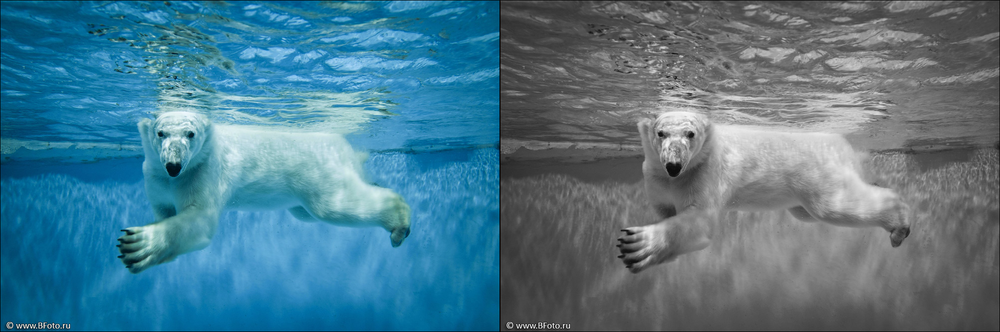

In [ ]:

img_bin = cv.imread('/content/output.jpg')
i = np.concatenate((img_color, img_bin), axis=1)
cv2_imshow(i)



## **Задание 2:**  
Используя режим `cv2.IMREAD_UNCHANGED`, загрузите изображение с альфа-каналом (например, PNG с прозрачностью). Затем:

- Разделите изображение на каналы (B, G, R, A).
- Создайте новое изображение, где прозрачность (альфа-канал) инвертирована (т.е. прозрачные области становятся непрозрачными и наоборот).
- Сохраните и отобразите полученное изображение.

In [ ]:
import pandas as pd

a = ('/content/koshka-1.png')
im = cv.imread(a, cv.IMREAD_UNCHANGED)
b_channel, g_channel, r_channel, a_channel = cv.split(im)
pa_arr = pd.DataFrame(a_channel)


In [ ]:
a_channel[a_channel <= np.median(a_channel)] = 255

a_channel[a_channel > np.median(a_channel)] = 0

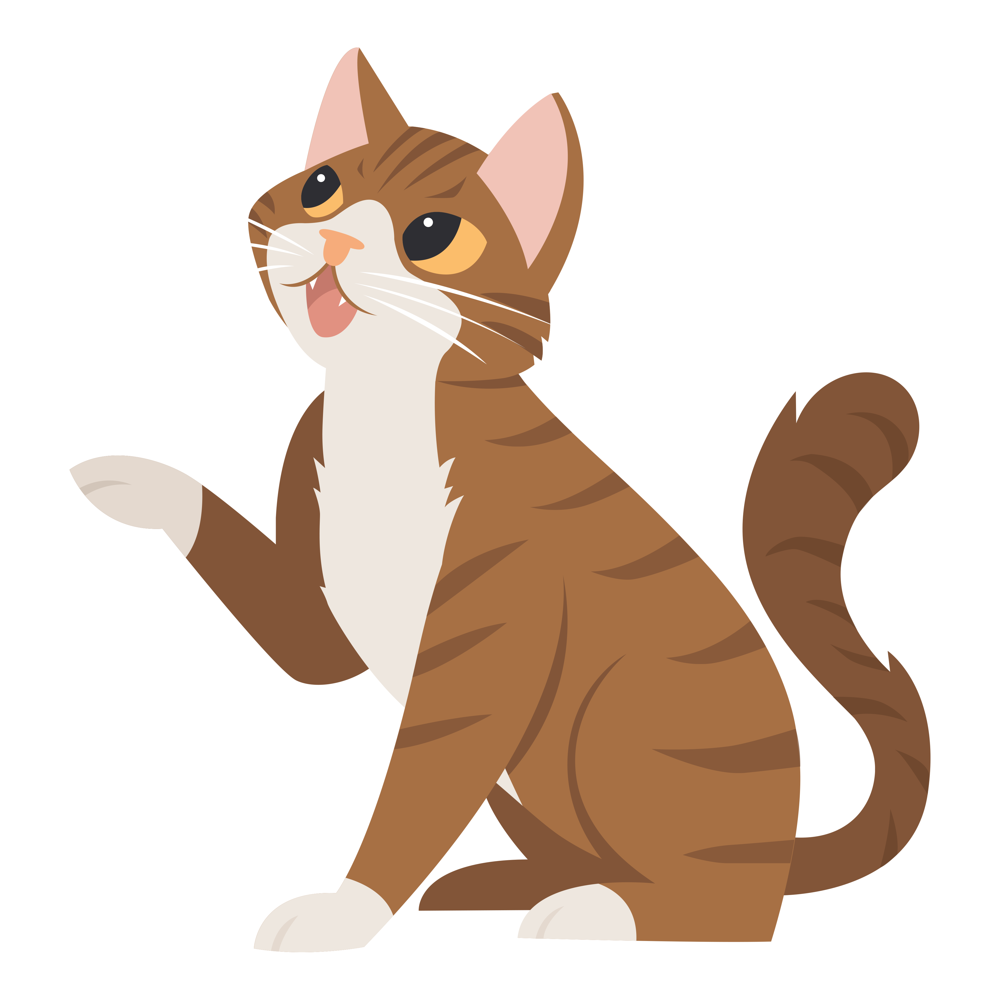

In [ ]:
cv2_imshow(im)

---

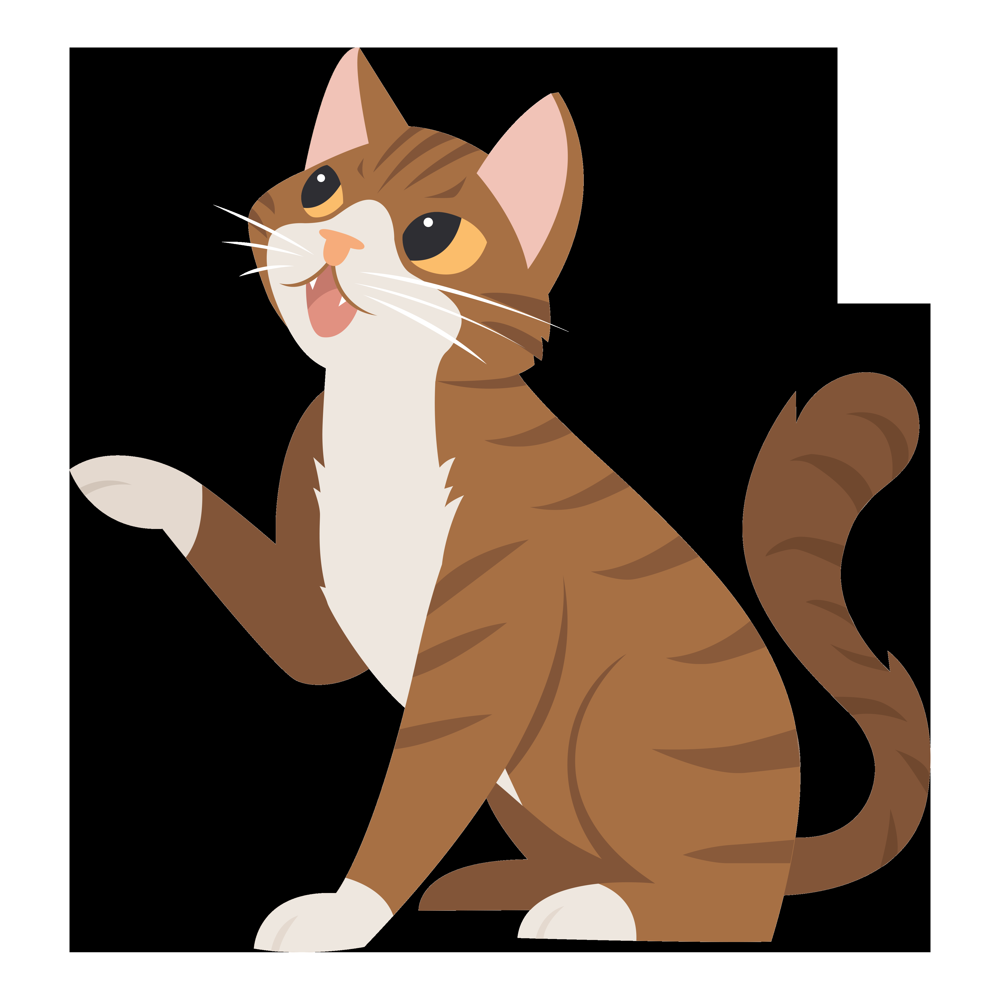

In [ ]:
img_ = cv.merge((b_channel, g_channel, r_channel, a_channel))
cv.imwrite('output_1.jpg', img_)
cv2_imshow(img_)

# **Тема №2. Работа с цветовыми палитрами**



## **Задание 3:**  
Напишите процедуру, которая:

- Считывает цветное изображение.
- Преобразует его из цветового пространства BGR в HSV с помощью `cv2.cvtColor()`.
- Увеличивает насыщенность (канал S) в 1.5 раза, не превышая максимального значения.
- Преобразует изображение обратно в цветовое пространство BGR.
- Отображает оригинальное и полученное изображения рядом для сравнения.

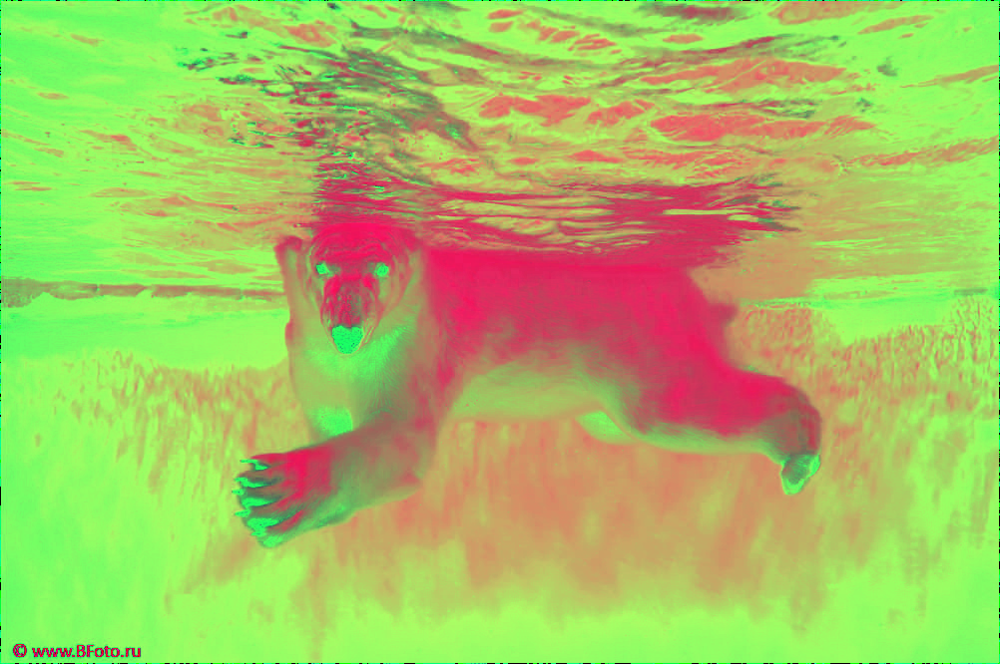

In [ ]:
image_path = ('/content/bfoto_ru_4807-foto-dlya-nalivnih-3d-polov.jpg')
img_color = cv.imread(image_path, cv.IMREAD_COLOR)
img_hsv = cv.cvtColor(img_color, cv.COLOR_BGR2HSV)
cv2_imshow(img_hsv)

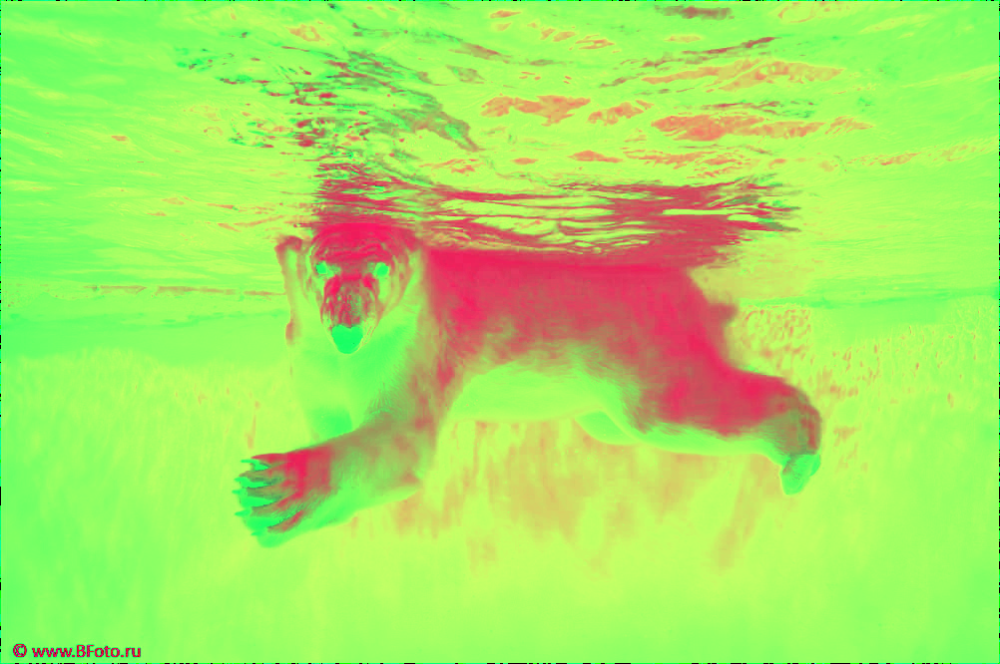

In [ ]:
h_channel, s_channel, v_channel = cv.split(img_hsv)
s_channel_enhanced = cv.multiply(s_channel, 1.5)
s_channel_enhanced = cv.min(s_channel_enhanced, 255)
img_enhanced = cv.merge((h_channel, s_channel_enhanced.astype(np.uint8), v_channel))
cv2_imshow(img_enhanced)

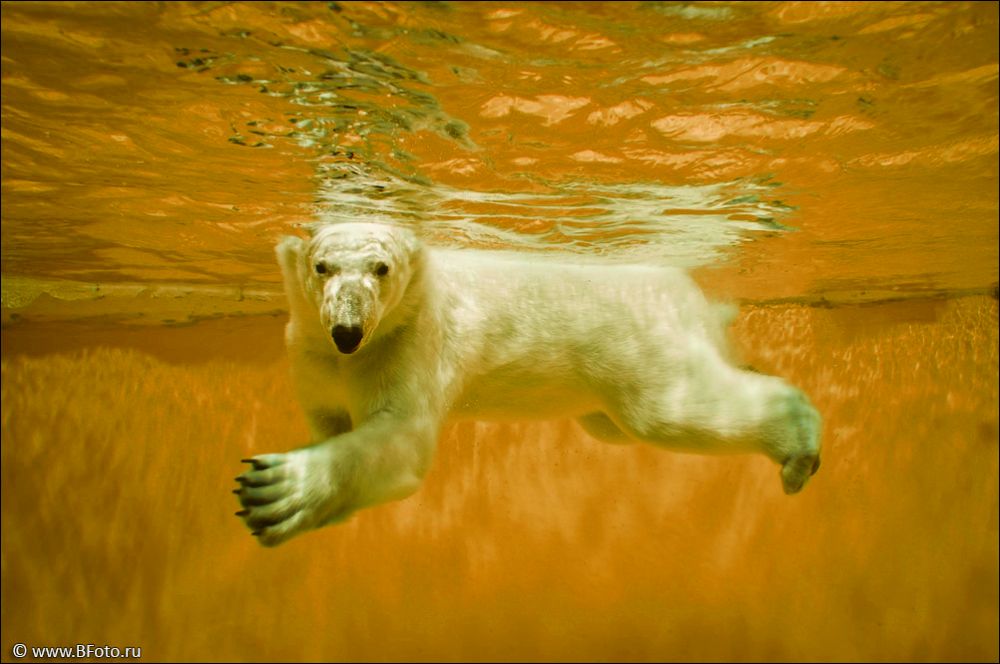

In [ ]:
img_enhanced_rgb = cv.cvtColor(img_enhanced, cv.COLOR_HSV2RGB)
cv2_imshow(img_enhanced_rgb)

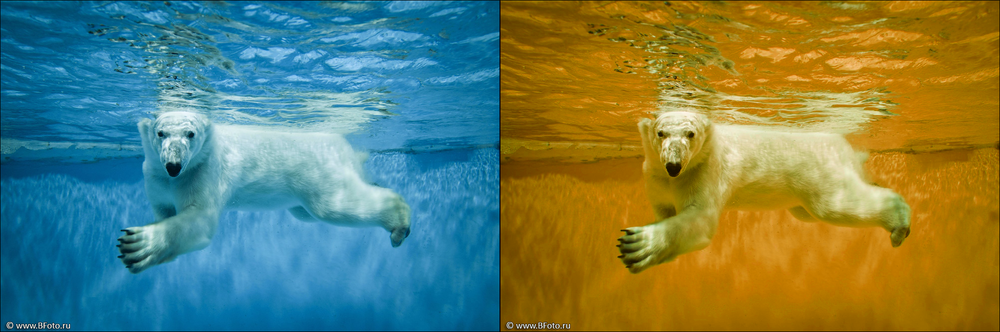

In [ ]:
i = np.concatenate((img_color, img_enhanced_rgb), axis=1)
cv2_imshow(i)

## **Задание 4:**  
Напишите процедуру, которая:

- Считывает изображение и Преобразует его в цветовое пространство YCrCb.
- Применяет размытие к компоненте яркости Y (при помощи фильтра, см. материал предыдущих занятий).
- Снова Преобразует изображение в цветовое пространство BGR.
- Отображает исходное и размытое изображения.

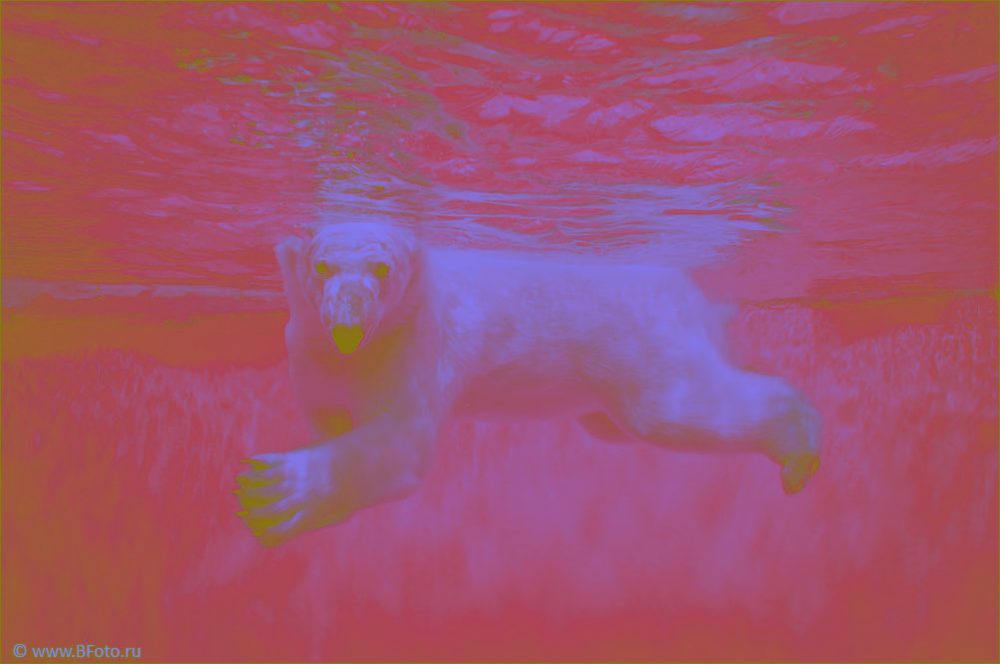

In [ ]:
img_color = cv.imread(image_path, cv.IMREAD_COLOR)
img_YCrCb = cv.cvtColor(img_color, cv.COLOR_BGR2YCrCb)
cv2_imshow(img_YCrCb)

In [ ]:
Y, Cr, Cb = cv.split(img_YCrCb)
Y_blurred = cv.GaussianBlur(Y, (5, 5), 0)
img_YCrCb_blurred = cv.merge([Y_blurred, Cr, Cb])
img_blurred = cv.cvtColor(img_YCrCb_blurred, cv.COLOR_YCrCb2BGR)


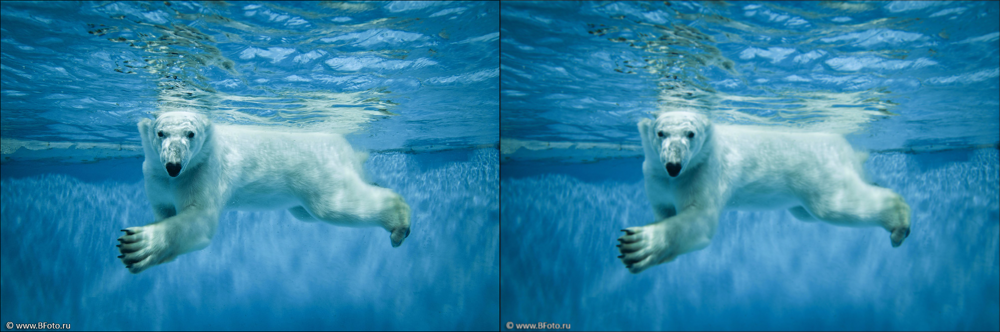

In [ ]:
i = np.concatenate((img_color, img_blurred), axis=1)
cv2_imshow(i)

---

# **Тема №3. Слияние и усиление**

## **Задание 5:**  
Создайте процедуру, которая:

- Считывает два изображения одинакового размера (можно подкорректировать с помощью метода `.resize()`).
- Выполняет побитовое ИЛИ (OR) над соответствующими пикселями двух изображений.
- Сохраняет и отображает результат операции.

In [ ]:

image_path_2 = '/content/1644811591_1-fikiwiki-com-p-prikolnie-kartinki-khoroshego-kachestva-1.jpg'

img1 = cv.imread(image_path, cv.IMREAD_COLOR)
img2 = cv.imread(image_path_2, cv.IMREAD_COLOR)

img2 = cv.resize(img2, (img1.shape[1], img1.shape[0]))

In [ ]:
result = cv.bitwise_or(img1, img2)
cv.imwrite('output_2.jpg', result)

True

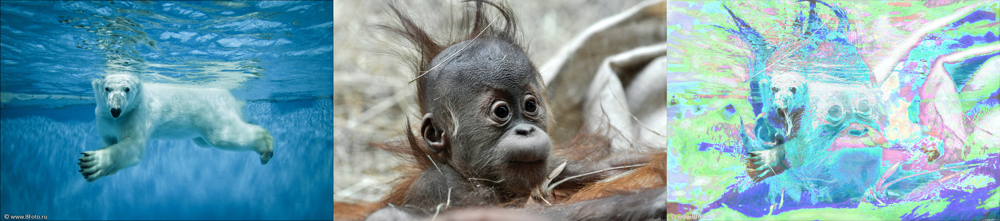

In [ ]:
i = np.concatenate((img1, img2, result), axis=1)
cv2_imshow(i)

## **Задание 6:**  
Реализуйте следующий алгоритм:

- Считайте цветное изображение и разделите его на три канала с использованием `.split()`.
- Примените к каждому каналу разный коэффициент гамма-коррекции (например, для R – 0.5, G – 1.0, B – 1.5).
- Объедините каналы обратно с помощью `.merge()`.
- Отобразите исходное и обработанное изображения.


In [ ]:
img_color = cv.imread(image_path, cv.IMREAD_COLOR)
b, g, r = cv.split(img_color)
b_enhanced = cv.multiply(b, 1.5)
g_enhanced = cv.multiply(g, 1.0)
r_enhanced = cv.multiply(r, 0.5)
img_ = cv.merge([b_enhanced, g_enhanced, r_enhanced])
img_1 = cv.cvtColor(img_, cv.COLOR_BGR2RGB)

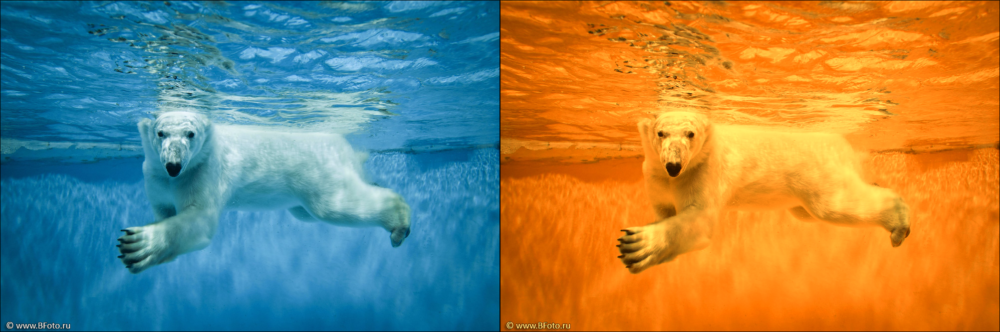

In [ ]:
i = np.concatenate((img_color, img_1), axis=1)
cv2_imshow(i)

---

# **Тема №4. Работа с гистограммами в OpenCV**

## **Задание 7:**  
Напишите процедуру для улучшения контрастности изображения:

- Считывает изображение в оттенках серого.
- Строит его гистограмму с использованием `cv.calcHist()`.
- Применяет эквализацию гистограммы методом `cv2.equalizeHist()`.
- Отображает на одном графике исходное и эквализованное изображения вместе с их гистограммами.

In [ ]:
img_color = cv.imread(image_path, cv.IMREAD_COLOR)
img_gray = cv.cvtColor(img_color, cv.COLOR_BGR2GRAY)

hist = cv.calcHist(
    [img_gray],  # [img] - список изображений, для которых нужно вычислить гистограмму. здесь только одно изображение.
    [0],    # [0] - индекс канала цвета (для серого изображения = 0, для B, G, R каналов цветных изображений будет 0, 1, 2 соответственно).
    None,   # Маска для выбора подмножества пикселей для расчета гистограммы. None значит, что маска не используется, и учитываются все пиксели.
    [256],  # [256] - количество "корзин" гистограммы, то есть размер выходной гистограммы. Значение 256 для 8-битных изображений.
    [0, 256]  # Диапазон значений пикселей для расчета гистограммы. Для стандартных 8-битных изображений диапазон - от 0 до 256.
)

img_equalized = cv.equalizeHist(img_gray)
hist_equalized = cv.calcHist([img_equalized], [0], None, [256], [0, 256])

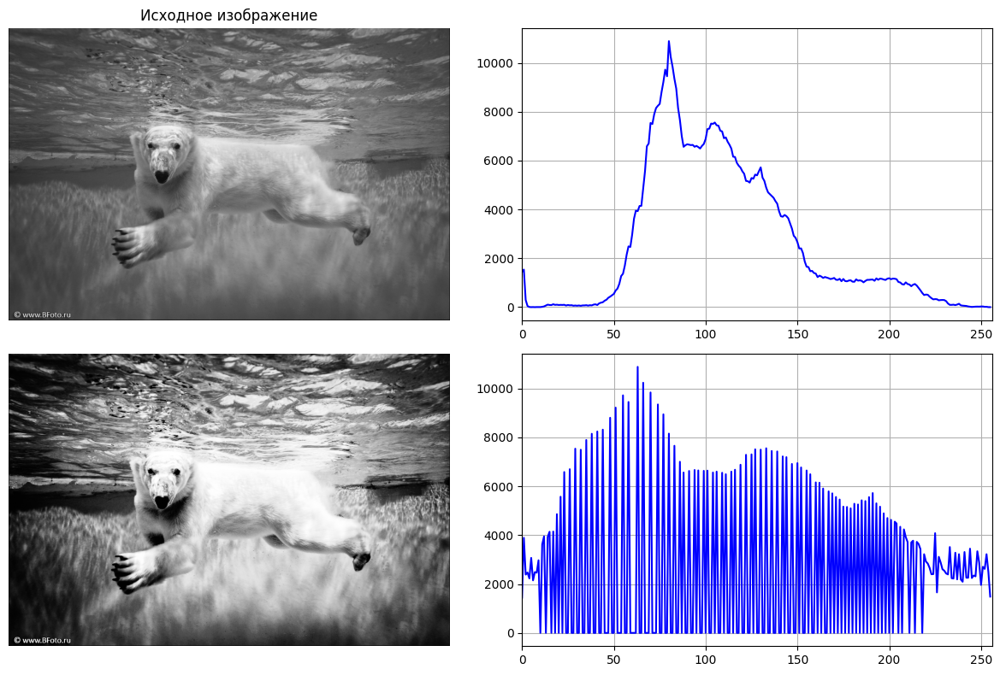

In [ ]:
plt.figure(figsize=(12, 8))

# Исходное изображение
plt.subplot(2, 2, 1)
plt.imshow(img_gray, cmap='gray')
plt.title('Исходное изображение')
plt.axis('off')

# Гистограмма исходного изображения
plt.subplot(2, 2, 2)
plt.plot(hist, color='blue')
plt.xlim([0, 256])
plt.grid(True)

# Эквализованное изображение
plt.subplot(2, 2, 3)
plt.imshow(img_equalized, cmap='gray')
plt.axis('off')

# Гистограмма эквализованного изображения
plt.subplot(2, 2, 4)
plt.plot(hist_equalized, color='blue')
plt.xlim([0, 256])
plt.grid(True)

plt.tight_layout()
plt.show()

## **Задание 8:**  
Используйте метод CLAHE для улучшения деталей в затемненных областях цветного изображения:

- Преобразуйте изображение из BGR в LAB цветовое пространство.
- Разделите изображение на каналы и примените `cv2.createCLAHE()` к каналу яркости L.
- Объедините обработанный канал L с исходными каналами A и B.
- Преобразуйте изображение обратно в BGR.
- Отобразите исходное и обработанное изображения для сравнения вместе с их гистограммами.

In [ ]:

img_color = cv.imread(image_path, cv.IMREAD_COLOR)
img_lab = cv.cvtColor(img_color, cv.COLOR_BGR2LAB)
l_channel, a_channel, b_channel = cv.split(img_lab)
clip_limit = 2.0
tile_grid_size = (8, 8)
clahe = cv.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
l_channel_clahe = clahe.apply(l_channel)
lab_clahe = cv.merge((l_channel_clahe, a_channel, b_channel))
img_bgr_clahe = cv.cvtColor(lab_clahe, cv.COLOR_LAB2BGR)
hist_original = cv.calcHist([l_channel], [0], None, [256], [0, 256])
hist_clahe = cv.calcHist([l_channel_clahe], [0], None, [256], [0, 256])

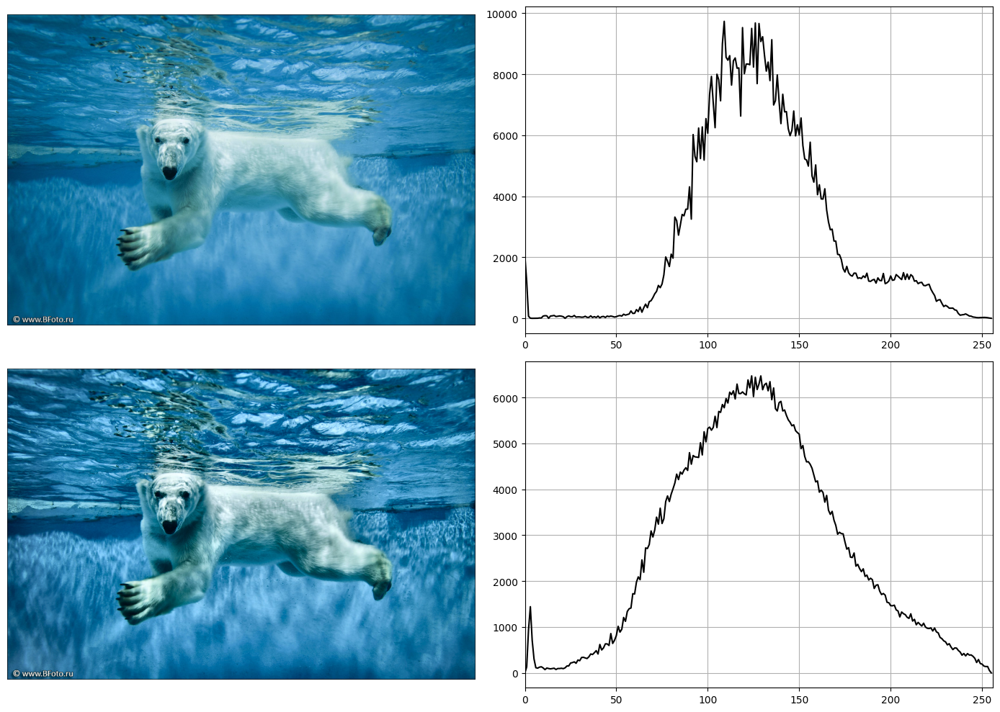

In [ ]:
plt.figure(figsize=(14, 10))

plt.subplot(2, 2, 1)
plt.imshow(cv.cvtColor(img_color, cv.COLOR_BGR2RGB))  # OpenCV использует BGR, Matplotlib — RGB
plt.axis('off')

plt.subplot(2, 2, 2)
plt.plot(hist_original, color='black')
plt.xlim([0, 256])
plt.grid(True)

plt.subplot(2, 2, 3)
plt.imshow(cv.cvtColor(img_bgr_clahe, cv.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(2, 2, 4)
plt.plot(hist_clahe, color='black')
plt.xlim([0, 256])
plt.grid(True)

plt.tight_layout()
plt.show()

## **Затем:**  
Исследуйте влияние размера окна (tileGridSize) и порога по сравнению с гистограммой (clipLimit) в методе CLAHE на конечный результат. Попробуйте несколько различных значений и визуализируйте результаты.


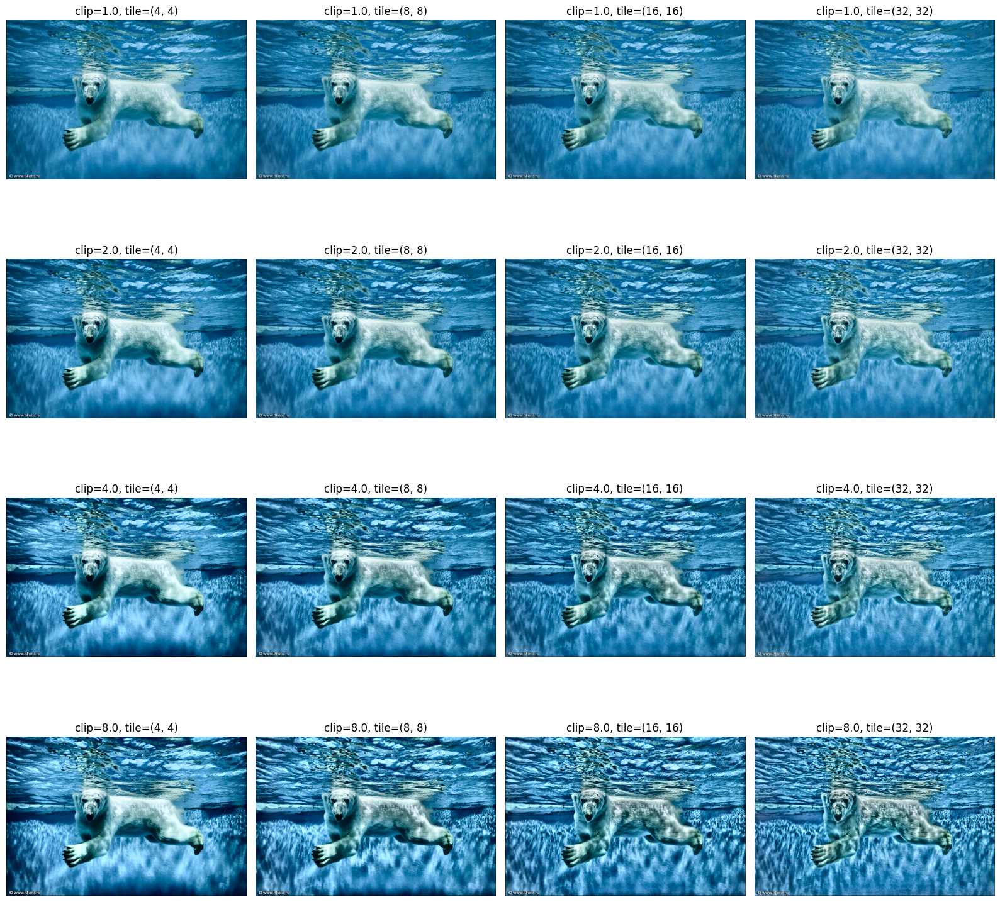

In [ ]:

img = cv.imread(image_path, cv.IMREAD_COLOR)

# Преобразуем в LAB → берём канал L
lab = cv.cvtColor(img, cv.COLOR_BGR2LAB)
l, a, b = cv.split(lab)

# Список параметров, которые попробуем
clip_limits = [1.0, 2.0, 4.0, 8.0]
tile_sizes = [(4,4), (8,8), (16,16), (32,32)]

# Подготовим фигуру для визуализации
n = len(clip_limits)
m = len(tile_sizes)
fig, axes = plt.subplots(n, m, figsize=(4*m, 4*n))

for i, clip in enumerate(clip_limits):
    for j, tile in enumerate(tile_sizes):
        clahe = cv.createCLAHE(clipLimit=clip, tileGridSize=tile)
        l_cl = clahe.apply(l)
        img_lab_cl = cv.merge([l_cl, a, b])
        img_bgr_cl = cv.cvtColor(img_lab_cl, cv.COLOR_LAB2BGR)
        img_rgb_cl = cv.cvtColor(img_bgr_cl, cv.COLOR_BGR2RGB)
        ax = axes[i, j]
        ax.imshow(img_rgb_cl)
        ax.set_title(f"clip={clip}, tile={tile}")
        ax.axis('off')

plt.tight_layout()
plt.show()

---

# **Комплексное задание №1. Улучшение качества отсканированного документа с использованием OpenCV**



## **Краткое описание задания:**

- Необходимо написать функцию для улучшения качества отсканированного документа с использованием методов обработки изображений, изученных ранее. Функция должна принимать на вход изображение отсканированного документа и возвращать его улучшенную версию, готовую для дальнейшего использования, например, для распознавания текста.

Датасет с отсканированными изображениями можно найти в сети Интернет.

---



## **Алгоритм действий:**

#### **Реализуйте функцию на языке Python с использованием библиотеки OpenCV, которая выполняет следующие этапы обработки:**

### **1. Чтение, запись и отображение изображений:**

- Функция должна принимать на вход изображение отсканированного документа (например, в формате JPEG или PNG)
- Проверьте наличие альфа-канала в изображении и, если он присутствует, загрузите изображение в режиме `cv2.IMREAD_UNCHANGED`, иначе используйте `cv2.IMREAD_COLOR`
- Отобразите исходное изображение для визуальной проверки

### **2. Работа с цветовыми палитрами:**

- Преобразуйте изображение в оттенки серого, используя `cv2.cvtColor()` с параметром `cv2.COLOR_BGR2GRAY`.
- Отобразите полученное изображение в оттенках серого.

### **3. Слияние и усиление:**

- Примените медианный фильтр (`cv2.medianBlur()`) для удаления шумов с изображения. Выберите подходящий размер ядра (например, 3 или 5). Отобразите результат.
- Используйте фильтр сглаживания с применением прямой свертки (`cv2.filter2D()`) с заданным ядром для повышения четкости. Например, можно использовать фильтр "Unsharp Masking":
  - Создайте ядро для повышения резкости. Пример ядра:
    ```python
    kernel = np.array([[-1, -1, -1],
                       [-1,  9, -1],
                       [-1, -1, -1]])
    ```
  - Примените фильтр к изображению и отобразите результат.

### **4. Работа с гистограммами:**

- Примените метод CLAHE (Contrast Limited Adaptive Histogram Equalization) для улучшения контрастности изображения:
  - Создайте объект CLAHE с параметрами `clipLimit=2.0` и `tileGridSize=(8,8)`.
  - Примените CLAHE к изображению.
  - отобразите результат.
- Постройте гистограммы яркости исходного и обработанного изображений для сравнения.

---

### **Требования к функции:**

- Функция должна называться: `improve_scan(image)`, где `image` — входное изображение в виде массива NumPy.
- Функция должна возвращать улучшенное изображение в виде массива NumPy.
- В ходе работы функция должна **опционально** отображать промежуточные результаты для наглядности (в условиях Colab использовать соответствующие методы вывода изображений). Для этого следует ввести отдельный параметр (например: `visible=True`) и реализовать с ним соответствующую логику.

---

### **Дополнительные требования:**

- **Обработка ошибок:**
  - Убедитесь, что функция корректно обрабатывает ситуации, когда на вход подается некорректное изображение.
  - Добавьте проверки на тип входных данных.

- **Документация и комментарии:**
  - Функция должна быть снабжена понятной документацией: опишите, какие преобраования выполняются и для чего.
  - Добавьте комментарии к основным участкам кода для пояснения выполняемых действий.



---

### **Подсказки и рекомендации:**


- **Медианный фильтр:**
  Функция `cv2.medianBlur(src, ksize)` принимает на вход изображение и размер ядра (должен быть нечетным числом).

- **CLAHE:**
  - Создайте объект CLAHE с помощью `cv2.createCLAHE(clipLimit, tileGridSize)`.
  - Примените метод `apply()` к изображению в оттенках серого.

- **Отображение изображений в Google Colab:**
  - Используйте `matplotlib.pyplot` для отображения изображений.
  - Помните, что `cv2.imread()` загружает изображения в формате BGR, поэтому для корректного отображения в Matplotlib Преобразуйте изображение в RGB с помощью `cv2.cvtColor(image, cv2.COLOR_BGR2RGB)`.

---

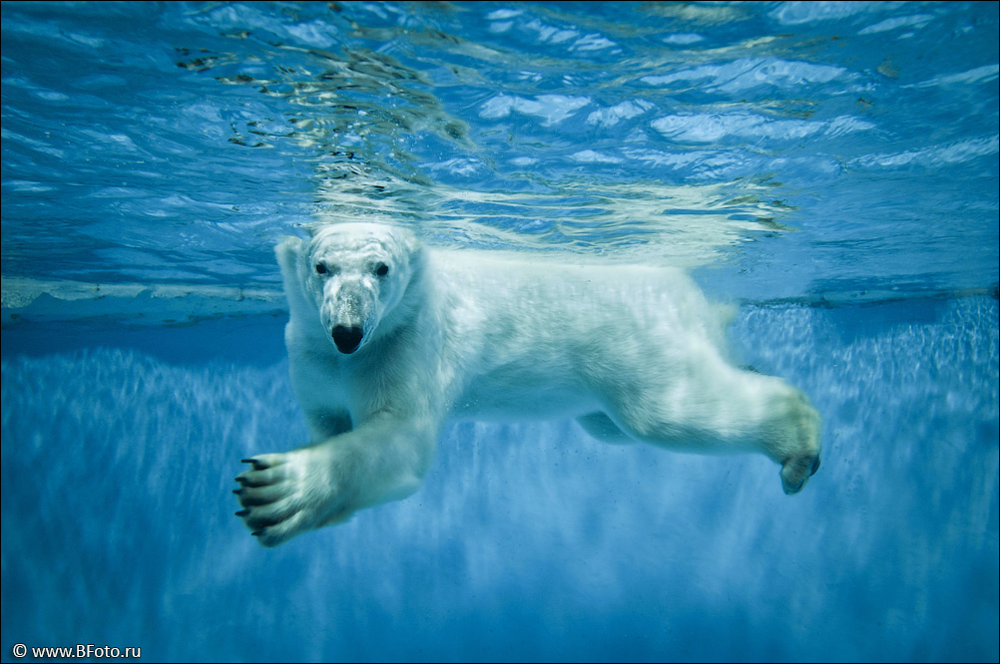

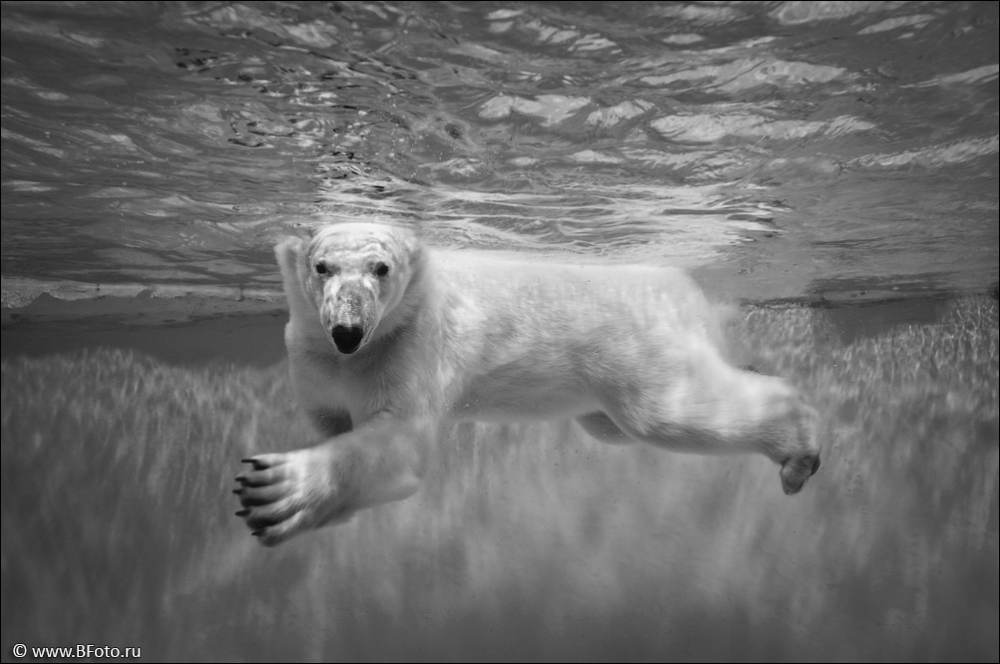

In [ ]:

img = cv.imread(image_path, cv.IMREAD_UNCHANGED)

if len(img.shape) == 3 and img.shape[2] == 4:
  img_color = cv.imread(image_path, cv.IMREAD_UNCHANGED)
else:
  img_color = cv.imread(image_path, cv.IMREAD_COLOR)


cv2_imshow(img_color)

img_gray = cv.cvtColor(img_color, cv.COLOR_BGR2GRAY)
cv2_imshow(img_gray)

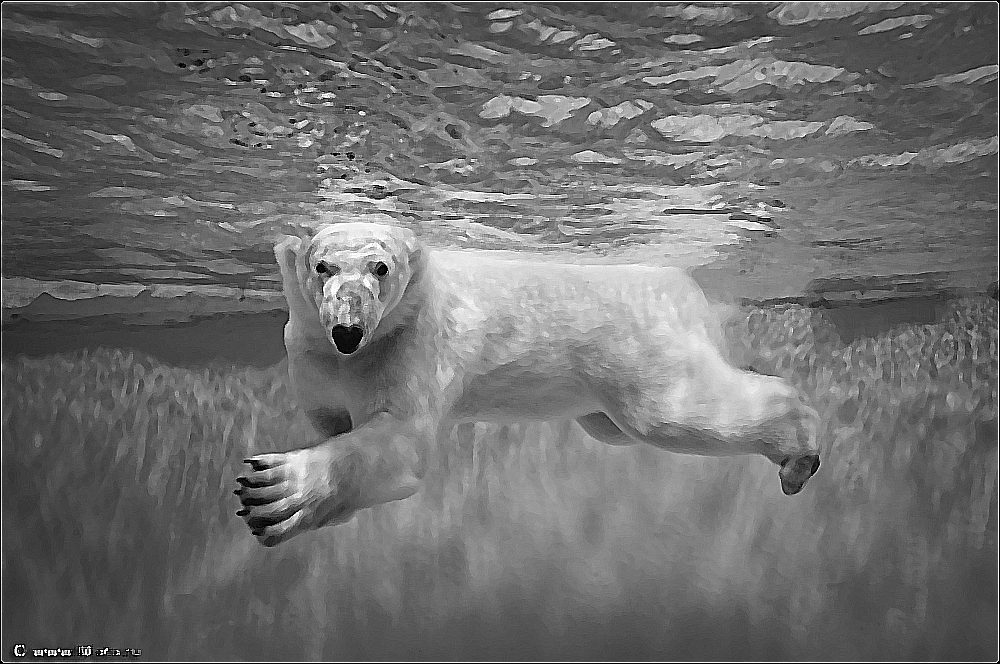

In [ ]:
img_median = cv.medianBlur(img_gray, ksize=5)

kernel = np.array([[-1, -1, -1],
                   [-1,  9, -1],
                   [-1, -1, -1]], dtype=np.float32)

img_sharpened = cv.filter2D(img_median, -1, kernel)
cv2_imshow(img_sharpened)

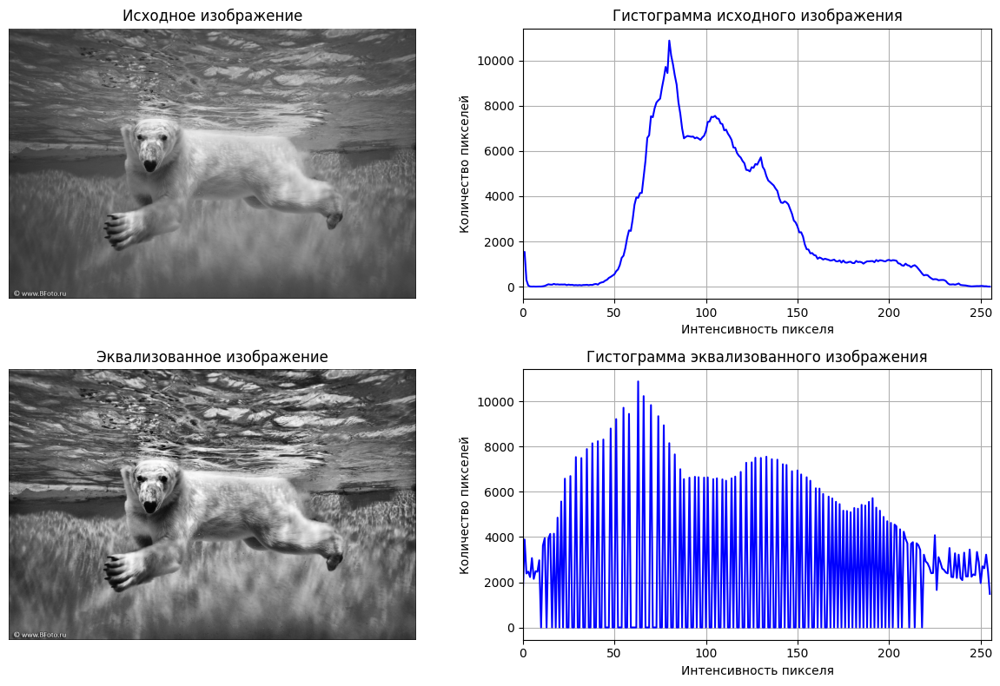

In [ ]:
clahe = cv.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
gray_clahe = clahe.apply(img_gray)

plt.figure(figsize=(12, 8))

# Исходное изображение
plt.subplot(2, 2, 1)
plt.imshow(img_gray, cmap='gray')
plt.title('Исходное изображение')
plt.axis('off')

# Гистограмма исходного изображения
plt.subplot(2, 2, 2)
plt.plot(hist, color='blue')
plt.title('Гистограмма исходного изображения')
plt.xlabel('Интенсивность пикселя')
plt.ylabel('Количество пикселей')
plt.xlim([0, 256])
plt.grid(True)

# Эквализованное изображение
plt.subplot(2, 2, 3)
plt.imshow(gray_clahe, cmap='gray')
plt.title('Эквализованное изображение')
plt.axis('off')

# Гистограмма эквализованного изображения
plt.subplot(2, 2, 4)
plt.plot(hist_equalized, color='blue')
plt.title('Гистограмма эквализованного изображения')
plt.xlabel('Интенсивность пикселя')
plt.ylabel('Количество пикселей')
plt.xlim([0, 256])
plt.grid(True)

plt.tight_layout()
plt.show()

In [ ]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

def improve_scan(image, visible=True):

    # Проверка входных данных
    if not isinstance(image, np.ndarray):
        raise TypeError("Входное изображение должно быть массивом NumPy (np.ndarray).")
    if image.size == 0:
        raise ValueError("Изображение пустое.")
    if len(image.shape) not in [2, 3]:
        raise ValueError("Неподдерживаемый формат изображения. Ожидаются 2D (grayscale) или 3D (цветное).")

    # Преобразование в оттенки серого, если изображение цветное
    if len(image.shape) == 3:
        # Если 4 канала (RGBA) — конвертируем в BGR, затем в серый
        if image.shape[2] == 4:
            image_gray = cv.cvtColor(image, cv.COLOR_BGRA2GRAY)
        elif image.shape[2] == 3:
            image_gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
        else:
            raise ValueError("Неподдерживаемое количество каналов. Ожидаются 1, 3 или 4 канала.")
    else:
        # Уже grayscale
        image_gray = image.copy()

    # Медианный фильтр для подавления шума
    img_median = cv.medianBlur(image_gray, ksize=5)

    # Применение CLAHE для улучшения контраста
    clahe = cv.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    img_clahe = clahe.apply(img_median)

    # Фильтр резкости для усиления деталей
    kernel = np.array([[-1, -1, -1],
                       [-1,  9, -1],
                       [-1, -1, -1]], dtype=np.float32)
    img_sharpened = cv.filter2D(img_clahe, -1, kernel)

    # Опциональное отображение промежуточных результатов
    if visible:
        plt.figure(figsize=(15, 10))

        # Исходное изображение
        plt.subplot(2, 2, 1)
        plt.imshow(image_gray, cmap='gray')
        plt.title('Исходное (Grayscale)')
        plt.axis('off')

        # После медианного фильтра
        plt.subplot(2, 2, 2)
        plt.imshow(img_median, cmap='gray')
        plt.title('После медианного фильтра')
        plt.axis('off')

        # После CLAHE
        plt.subplot(2, 2, 3)
        plt.imshow(img_clahe, cmap='gray')
        plt.title('После CLAHE')
        plt.axis('off')

        # После фильтра резкости
        plt.subplot(2, 2, 4)
        plt.imshow(img_sharpened, cmap='gray')
        plt.title('Улучшенное изображение')
        plt.axis('off')

        plt.tight_layout()
        plt.show()

    # === Возврат улучшенного изображения ===
    return img_sharpened

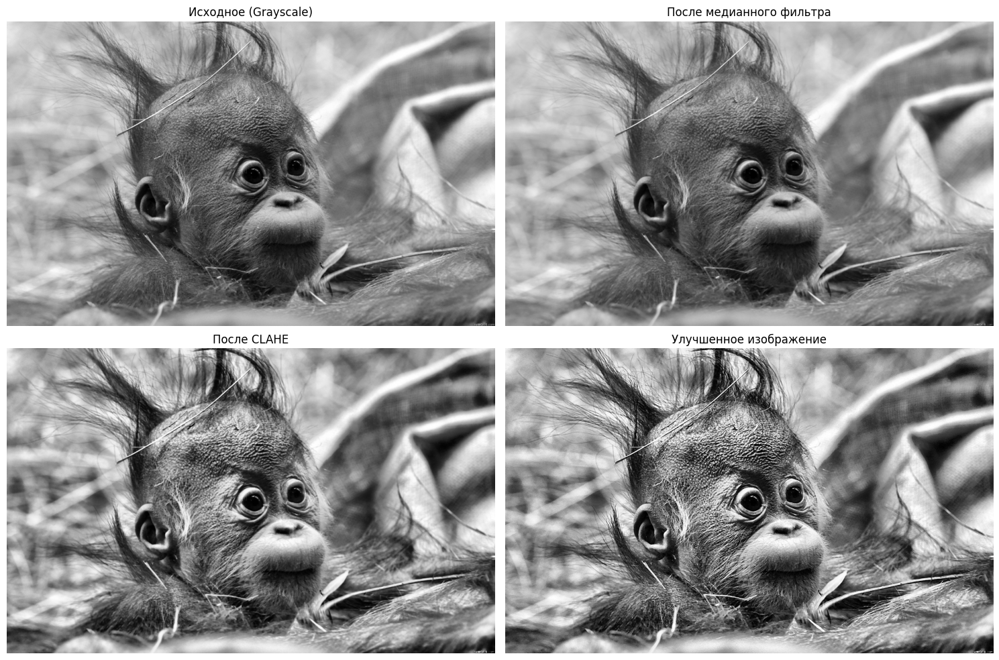

In [ ]:
image_path = '//content/1644811591_1-fikiwiki-com-p-prikolnie-kartinki-khoroshego-kachestva-1.jpg'
img = cv.imread(image_path, cv.IMREAD_UNCHANGED)

# Применение функции улучшения
improved_img = improve_scan(img, visible=True)

## **Дополнительное задание:**

- Поэкспериментируйте с параметрами медианного фильтра, ядром для фильтра повышения резкости и параметрами CLAHE для достижения наилучшего результата.
- Добавьте возможность передачи этих параметров в функцию `improve_scan` для более гибкой настройки обработки. **В качестве параметров по умолчанию установите те, которые показали себя лучше всего по результатам экспериментов**

**Пример с параметрами:**

```python
def improve_scan(image,
                 median_kernel_size=3,
                 sharp_kernel= np.array([[-1, -1, -1],
                                         [-1,  9, -1],
                                         [-1, -1, -1]]),
                 clahe_clip=2.0,
                 clahe_grid=(8,8),
                 visible=True):
    # Реализация с учетом переданных параметров
    ...
```


In [ ]:
def improve_scan(image,
                 median_kernel_size=3,
                 sharp_kernel= np.array([[-1, -1, -1],
                                         [-1,  9, -1],
                                         [-1, -1, -1]]),
                 clahe_clip=2.0,
                 clahe_grid=(8,8),
                 visible=True):

    # Проверка входных данных
    if not isinstance(image, np.ndarray):
        raise TypeError("Входное изображение должно быть массивом NumPy (np.ndarray).")
    if image.size == 0:
        raise ValueError("Изображение пустое.")
    if len(image.shape) not in [2, 3]:
        raise ValueError("Неподдерживаемый формат изображения. Ожидаются 2D (grayscale) или 3D (цветное).")

    # Преобразование в оттенки серого, если изображение цветное
    if len(image.shape) == 3:
        # Если 4 канала (RGBA) — конвертируем в BGR, затем в серый
        if image.shape[2] == 4:
            image_gray = cv.cvtColor(image, cv.COLOR_BGRA2GRAY)
        elif image.shape[2] == 3:
            image_gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
        else:
            raise ValueError("Неподдерживаемое количество каналов. Ожидаются 1, 3 или 4 канала.")
    else:
        # Уже grayscale
        image_gray = image.copy()

    # Медианный фильтр для подавления шума
    img_median = cv.medianBlur(image_gray, ksize=7)

    # Применение CLAHE для улучшения контраста
    clahe = cv.createCLAHE(clipLimit=5.0, tileGridSize=(8, 8))
    img_clahe = clahe.apply(img_median)

    # Фильтр резкости для усиления деталей
    kernel = np.array([[-1, -1, -1],
                       [-1,  10, -1],
                       [-1, -1, -1]], dtype=np.float32)
    img_sharpened = cv.filter2D(img_clahe, -1, kernel)

    # Опциональное отображение промежуточных результатов
    if visible:
        plt.figure(figsize=(15, 10))

        # Исходное изображение
        plt.subplot(2, 2, 1)
        plt.imshow(image_gray, cmap='gray')
        plt.title('Исходное (Grayscale)')
        plt.axis('off')

        # После медианного фильтра
        plt.subplot(2, 2, 2)
        plt.imshow(img_median, cmap='gray')
        plt.title('После медианного фильтра')
        plt.axis('off')

        # После CLAHE
        plt.subplot(2, 2, 3)
        plt.imshow(img_clahe, cmap='gray')
        plt.title('После CLAHE')
        plt.axis('off')

        # После фильтра резкости
        plt.subplot(2, 2, 4)
        plt.imshow(img_sharpened, cmap='gray')
        plt.title('Улучшенное изображение')
        plt.axis('off')

        plt.tight_layout()
        plt.show()

    # === Возврат улучшенного изображения ===
    return img_sharpened

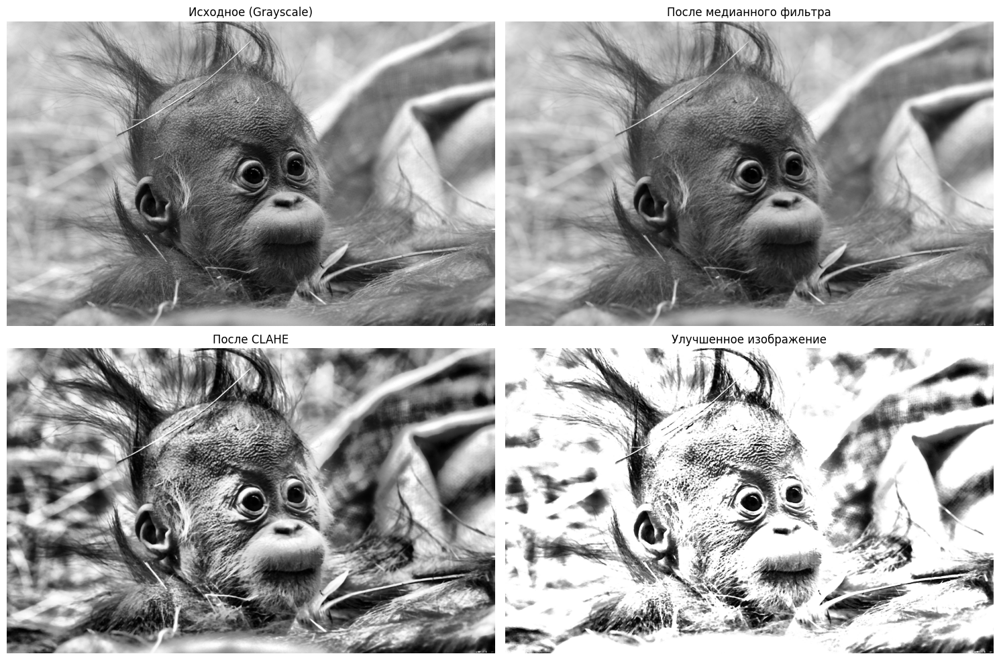

In [ ]:
img = cv.imread(image_path, cv.IMREAD_UNCHANGED)

# Применение функции улучшения
improved_img = improve_scan(img, visible=True)